In [1]:
import torch
import numpy as np
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report

from scarches.dataset.trvae.data_handling import remove_sparsity
from lataq.models import EMBEDCVAE
from lataq.exp_dict import EXPERIMENT_INFO

sc.settings.set_figure_params(dpi=200, frameon=False)
sc.set_figure_params(dpi=500)
plt.rcParams['figure.figsize'] = (5, 5)
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)
sc.settings.verbosity = 2
%load_ext autoreload
%autoreload 2

In [2]:
PARAMS = {
    'EPOCHS': 50,                                      #TOTAL TRAINING EPOCHS
    'N_PRE_EPOCHS': 40,                                #EPOCHS OF PRETRAINING WITHOUT LANDMARK LOSS
    #'DATA_DIR': '../../lataq_reproduce/data',          #DIRECTORY WHERE THE DATA IS STORED
    #'DATA': 'pancreas',                                #DATA USED FOR THE EXPERIMENT
    'EARLY_STOPPING_KWARGS': {                         #KWARGS FOR EARLY STOPPING
        "early_stopping_metric": "val_landmark_loss",  ####value used for early stopping
        "mode": "min",                                 ####choose if look for min or max
        "threshold": 0,
        "patience": 20,
        "reduce_lr": True,
        "lr_patience": 13,
        "lr_factor": 0.1,
    },
    'LABELED_LOSS_METRIC': 'dist',           
    'UNLABELED_LOSS_METRIC': 'dist',
    'LATENT_DIM': 25,
    'ALPHA_EPOCH_ANNEAL': 1e3,
    'CLUSTERING_RES': 2,
    'HIDDEN_LAYERS': 3,
    'ETA': 5,
}

In [3]:
adata_raw = sc.read(
    '/storage/groups/ml01/workspace/'
    'hlca_lisa.sikkema_malte.luecken/'
    'HLCA_reproducibility/data/HLCA_extended/'
    'extension_datasets/ready/subsetted/lambrechts_sub.h5ad'
)

In [4]:
adata_raw

AnnData object with n_obs × n_vars = 93575 × 2000
    obs: 'n_genes_detected', 'total_counts', 'cell_from_tumor', 'subject_ID', 'tumor_site', 'original_celltype_ann', 'sample', 'study', 'study_long', 'dataset', 'last_author_PI', 'lung_vs_nasal', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'ann_highest_res', 'ann_new', 'scanvi_label'
    var: 'original_gene_names', 'gene_symbols', 'ensembl'

In [5]:
adata = sc.read(
    '../data/hlca_counts.h5ad'
)
#adata = adata[:, adata.var.highly_variable].copy()
#adata.X

In [6]:
adata_raw.obs['ann_finest_level'] = [
        adata_raw.obs.loc[cell, f"ann_level_{highest_lev}"]
        for cell, highest_lev in zip(
            adata_raw.obs.index, adata_raw.obs.ann_highest_res
        )
]

In [7]:
adata.var

,n_cells,highly_variable,means,dispersions,feature_biotype,feature_is_filtered,feature_name,feature_reference
ENSG00000000938,107870,True,0.203495,1.104081,gene,False,FGR,NCBITaxon:9606
ENSG00000000971,113428,True,0.188413,1.086728,gene,False,CFH,NCBITaxon:9606
ENSG00000002587,82919,True,0.158216,1.075575,gene,False,HS3ST1,NCBITaxon:9606
ENSG00000002933,36999,True,0.061320,1.334051,gene,False,TMEM176A,NCBITaxon:9606
ENSG00000003436,136851,True,0.270989,1.222142,gene,False,TFPI,NCBITaxon:9606
...,...,...,...,...,...,...,...,...
ENSG00000280721,8525,True,0.020283,1.336027,gene,False,LINC01943,NCBITaxon:9606
ENSG00000281103,20411,True,0.032217,1.255326,gene,False,TRG-AS1,NCBITaxon:9606
ENSG00000282122,28,True,0.000105,1.017615,gene,False,IGHV7-4-1,NCBITaxon:9606
ENSG00000282988,9370,True,0.014238,1.204348,gene,False,RP1-34B20.21,NCBITaxon:9606


In [13]:
adata_raw.var = adata_raw.var.set_index('ensembl')

In [14]:
adata_raw = adata_raw[:, adata.var_names]

ERROR! Session/line number was not unique in database. History logging moved to new session 4001
normalizing counts per cell
    finished (0:00:00)
computing neighbors
         Falling back to preprocessing with `sc.pp.pca` and default params.
computing PCA
    with n_comps=50
    finished (0:00:01)
    finished (0:00:34)
computing UMAP
    finished (0:00:23)


... storing 'ann_finest_level' as categorical


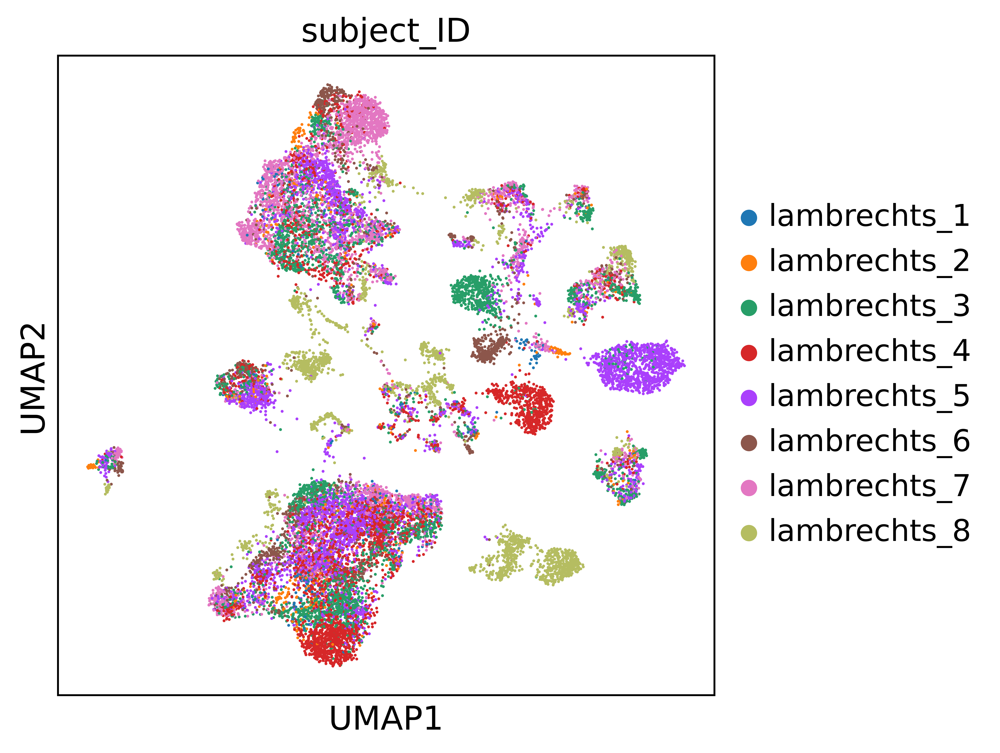

In [6]:
adata_pp = adata_raw.copy()
sc.pp.normalize_total(adata_pp)
sc.pp.log1p(adata_pp)

adata_raw_sub = sc.pp.subsample(adata_pp, n_obs=20000, copy=True)
sc.pp.neighbors(adata_raw_sub)
sc.tl.umap(adata_raw_sub, random_state=0)
sc.pl.umap(adata_raw_sub, color='subject_ID')

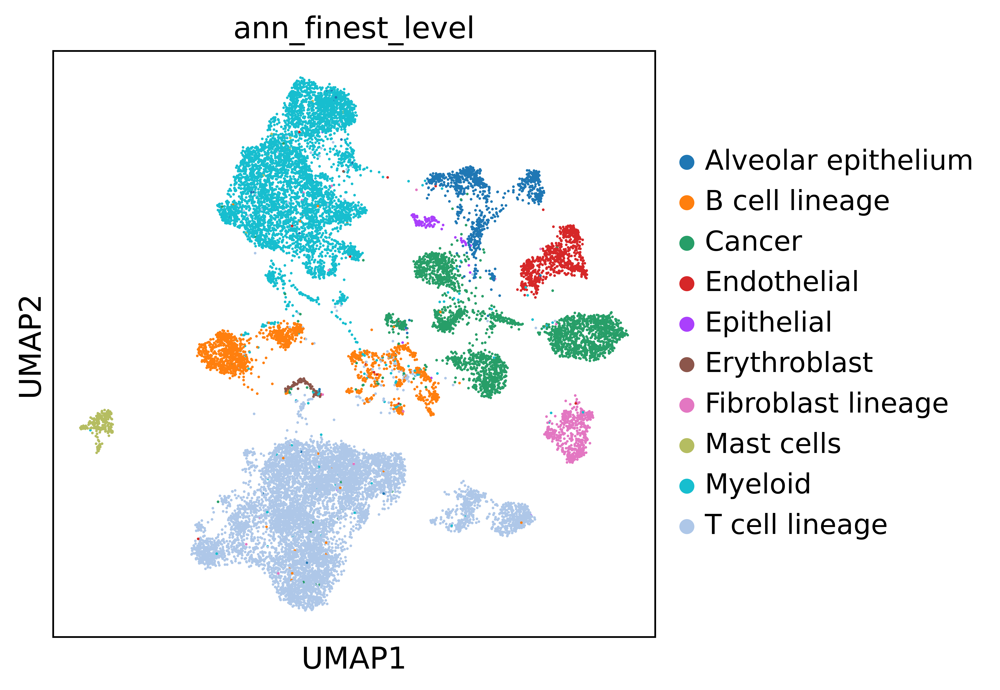

In [7]:
sc.pl.umap(adata_raw_sub, color='ann_finest_level')

In [15]:
condition_key = 'subject_ID'
cell_type_key = ['ann_finest_level']

In [9]:
adata_raw.var = adata_raw.var.set_index('ensembl')

In [16]:
lataq_query = EMBEDCVAE.load_query_data(
    adata=adata_raw,
    reference_model='hlca_core_3/',
    labeled_indices=[],
)

AnnData object with n_obs × n_vars = 93575 × 1996
    obs: 'n_genes_detected', 'total_counts', 'cell_from_tumor', 'subject_ID', 'tumor_site', 'original_celltype_ann', 'sample', 'study', 'study_long', 'dataset', 'last_author_PI', 'lung_vs_nasal', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'ann_highest_res', 'ann_new', 'scanvi_label', 'ann_finest_level'
    var: 'original_gene_names', 'gene_symbols'
Embedding dictionary:
 	Num conditions: 115
 	Embedding dim: 32
Encoder Architecture:
	Input Layer in, out and cond: 1996 128 32
	Hidden Layer 1 in/out: 128 128
	Mean/Var Layer in/out: 128 50
Decoder Architecture:
	First Layer in, out and cond:  50 128 32
	Hidden Layer 1 in/out: 128 128
	Output Layer in/out:  128 1996 

107


In [17]:
lataq_query.train(
    n_epochs=50,
    pretraining_epochs=40,
    early_stopping_kwargs=PARAMS['EARLY_STOPPING_KWARGS'],
    alpha_epoch_anneal=PARAMS['ALPHA_EPOCH_ANNEAL'],
    eta=0,
    clustering_res=PARAMS['CLUSTERING_RES'],
    labeled_loss_metric=PARAMS['LABELED_LOSS_METRIC'],
    unlabeled_loss_metric=PARAMS['UNLABELED_LOSS_METRIC'],
    weight_decay=0,
    use_stratified_sampling=False
)

Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
loaders init
loaders init done
0.0005908012390136719
 |████████████████----| 80.0%  - val_loss: 688.3688189532 - val_trvae_loss: 688.3688189532
Initializing unlabeled landmarks with Leiden-Clustering with an unknown number of clusters.
computing neighbors
    using data matrix X directly
    finished (0:00:46)
running Leiden clustering
    finished (0:00:52)
Leiden Clustering succesful. Found 46 clusters.
 |████████████████████| 100.0%  - val_loss: 686.1173433871 - val_trvae_loss: 686.1173433871 - val_landmark_loss: 0.0000000000 - val_unlabeled_loss: 0.4553953687
Saving best state of network...
Best State was in Epoch 40


In [18]:
results_dict = lataq_query.classify(
    adata_raw.X.A, 
    adata_raw.obs[condition_key], 
    metric=PARAMS['LABELED_LOSS_METRIC'],
    get_prob=False,
    threshold=-np.inf
)


In [19]:
def gini(array):
    """Calculate the Gini coefficient of a numpy array."""
    # based on bottom eq: http://www.statsdirect.com/help/content/image/stat0206_wmf.gif
    # from: http://www.statsdirect.com/help/default.htm#nonparametric_methods/gini.htm
    array = array.flatten() #all values are treated equally, arrays must be 1d
    if np.amin(array) < 0:
        array -= np.amin(array) #values cannot be negative
    array += 0.0000001 #values cannot be 0
    array = np.sort(array) #values must be sorted
    index = np.arange(1,array.shape[0]+1) #index per array element
    n = array.shape[0]#number of array elements
    return ((np.sum((2 * index - n  - 1) * array)) / (n * np.sum(array))) #Gini coefficient

In [20]:
results_dict[cell_type_key[0]]['gini'] = [
    gini(results_dict[cell_type_key[0]]['weighted_distances'][i]) 
    for i in range(len(results_dict[cell_type_key[0]]['weighted_distances']))
]

In [22]:
len(results_dict[cell_type_key[0]]['probs'])

93575

In [23]:
ct_map = {
        "Alveolar epithelium": ["AT1", "AT2", "AT2 proliferating"],
        "B cell lineage": ["B cells", "Plasma cells"],
        "Cancer": ["New"],
        "Endothelial": [
            "EC arterial",
            "EC aerocyte capillary",
            "EC general capillary",
            "EC venous systemic",
            "EC venous pulmonary",
            "Lymphatic EC mature",
            "Lymphatic EC proliferating",
            "Lymphatic EC differentiating",
        ],
        "Epithelial": [
            "Basal resting",
            "Suprabasal",
            "Deuterosomal",
            "Multiciliated (nasal)",
            "Multiciliated (non-nasal)",
            "Club (non-nasal)",
            "Club (nasal)",
            "Goblet (nasal)",
            "Goblet (bronchial)",
            "Goblet (subsegmental)",
            "Transitional Club-AT2",
            "Ionocyte",
            "Tuft",
            "Neuroendocrine",
            "SMG serous (nasal)",
            "SMG serous (bronchial)",
            "SMG mucous",
            "SMG duct",
            "AT1",
            "AT2",
            "AT2 proliferating",
        ],
        "Erythroblast": ["New"],
        "Fibroblast lineage": [
            "Peribronchial fibroblasts",
            "Adventitial fibroblasts",
            "Alveolar fibroblasts",
            "Pericytes",
            "Subpleural fibroblasts",
            "Myofibroblasts",
            "Smooth muscle",
            "Fibromyocytes",
            "SM activated stress response",
        ],  # they don't distinguish between fibroblasts and smooth muscle
        "Mast cells": ["Mast cells"],
        "Myeloid": [
            "DC1",
            "DC2",
            "Migratory DCs",
            "Plasmacytoid DCs",
            "Alveolar macrophages",
            "Alveolar Mφ CCL3+",
            "Alveolar Mφ MT-positive",
            "Alveolar Mφ proliferating",
            "Monocyte-derived Mφ",
            "Interstitial Mφ perivascular",
            "Classical monocytes",
            "Non-classical monocytes",
            "Mast cells",
        ],
        "T cell lineage": [
            "CD4 T cells",
            "CD8 T cells",
            "T cells proliferating",
            "NK cells",
        ],  # these are also NK cells
    }

In [24]:
plt.rcParams['figure.dpi'] = 250

In [25]:
data_latent = lataq_query.get_latent(
    adata.X.A.astype('float32'), 
    adata.obs[condition_key].values
)

adata_latent_ref = sc.AnnData(data_latent)
adata_latent_ref.obs = adata.obs.copy()
adata_latent_sub_ref = sc.pp.subsample(adata_latent_ref, n_obs=40000, copy=True)
#sc.pp.neighbors(adata_latent_sub_ref, n_neighbors=10)
#sc.tl.umap(adata_latent_sub_ref)
#sc.pl.umap(adata_latent_sub_ref, color='subject_ID')

computing neighbors
    using data matrix X directly
    finished (0:00:03)
computing UMAP
    finished (0:00:22)
computing neighbors
    using data matrix X directly
    finished (0:00:09)
computing UMAP
    finished (0:02:16)


... storing 'assay_ontology_term_id' as categorical
... storing 'cell_type_ontology_term_id' as categorical
... storing 'development_stage_ontology_term_id' as categorical
... storing 'disease_ontology_term_id' as categorical
... storing 'ethnicity_ontology_term_id' as categorical
... storing 'tissue_ontology_term_id' as categorical
... storing 'organism_ontology_term_id' as categorical
... storing 'sex_ontology_term_id' as categorical
... storing 'sample' as categorical
... storing 'study' as categorical
... storing 'subject_ID' as categorical
... storing 'smoking_status' as categorical
... storing 'condition' as categorical
... storing 'subject_type' as categorical
... storing 'sample_type' as categorical
... storing "3'_or_5'" as categorical
... storing 'sequencing_platform' as categorical
... storing 'cell_ranger_version' as categorical
... storing 'fresh_or_frozen' as categorical
... storing 'dataset' as categorical
... storing 'anatomical_region_level_2' as categorical
... storin

the obs value 'subject_ID' has more than 103 categories. Uniform 'grey' color will be used for all categories.


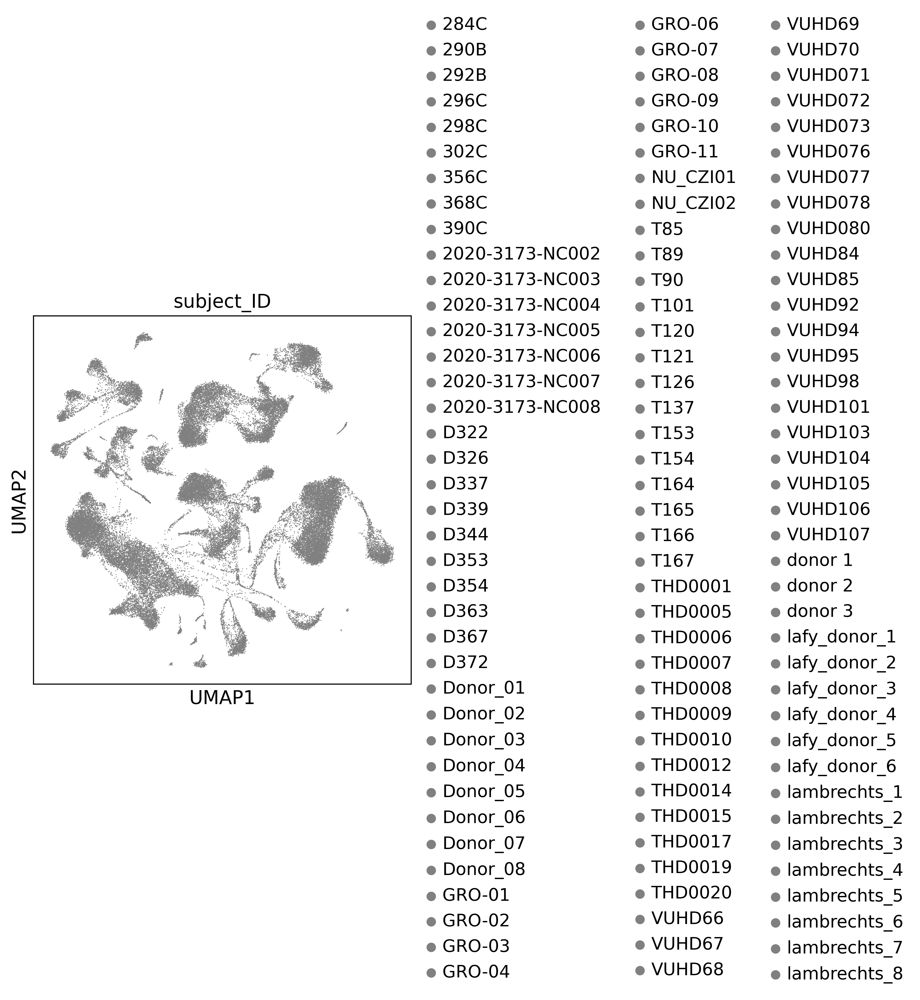

In [31]:
data_latent = lataq_query.get_latent(
    adata_raw.X.A, 
    adata_raw.obs[condition_key].values
)

adata_latent = sc.AnnData(data_latent)
adata_latent.obs = adata_raw.obs.copy()
adata_latent.obs['probs'] = results_dict[cell_type_key[0]]['probs']
adata_latent.obs['pred'] = results_dict['ann_finest_level']['preds']
adata_latent.obs['gini'] = results_dict['ann_finest_level']['gini']
adata_latent.obs['outcome'] = [
    adata_latent.obs['pred'].iloc[i] in ct_map[adata_latent.obs['ann_finest_level'].iloc[i]] for i in range(len(adata_latent))
]
adata_latent_sub = sc.pp.subsample(adata_latent, n_obs=20000, copy=True)

#adata_latent_concat = adata_latent_sub_ref.concatenate(adata_latent_sub)
sc.pp.neighbors(adata_latent_sub, n_neighbors=10)
sc.tl.umap(adata_latent_sub)

adata_latent_concat = adata_latent_sub_ref.concatenate(adata_latent_sub)
sc.pp.neighbors(adata_latent_concat, n_neighbors=10)
sc.tl.umap(adata_latent_concat)
sc.pl.umap(adata_latent_concat, color='subject_ID')

In [32]:
adata_latent_concat.obs['query'] = adata_latent_concat.obs['subject_ID'].str.contains('lambrechts').astype(str)

... storing 'query' as categorical


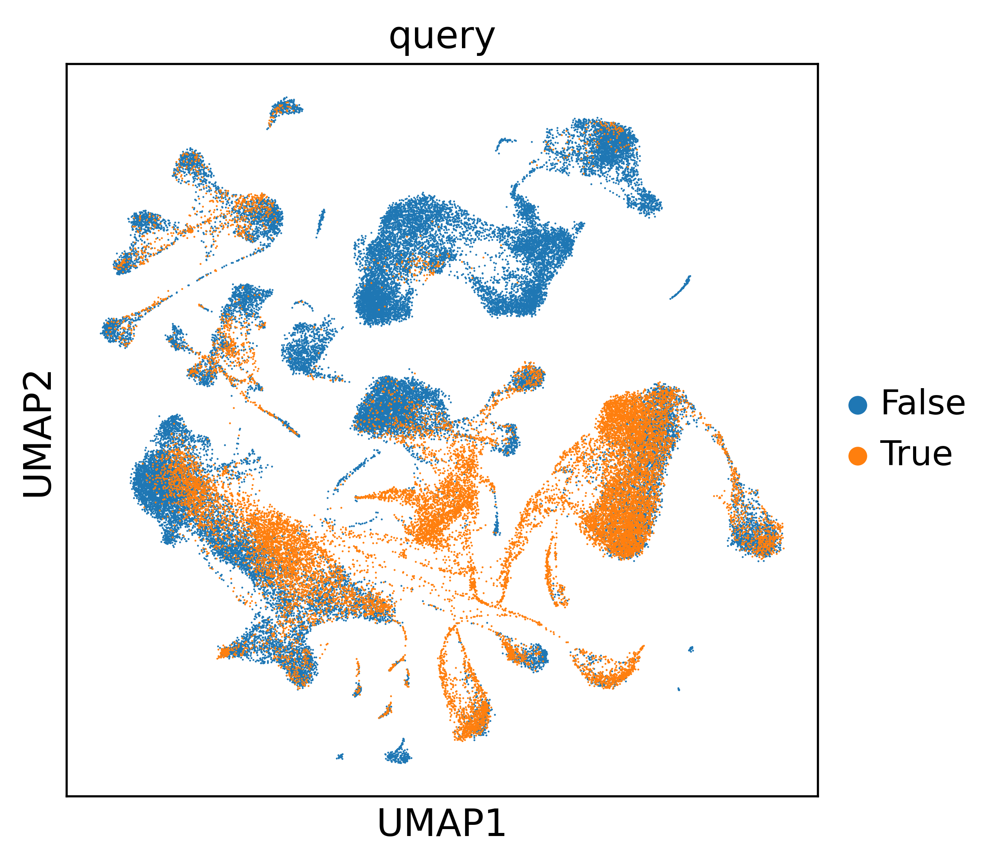

In [33]:
sc.pl.umap(adata_latent_concat, color='query')

... storing 'ann_finest_level' as categorical
... storing 'pred' as categorical


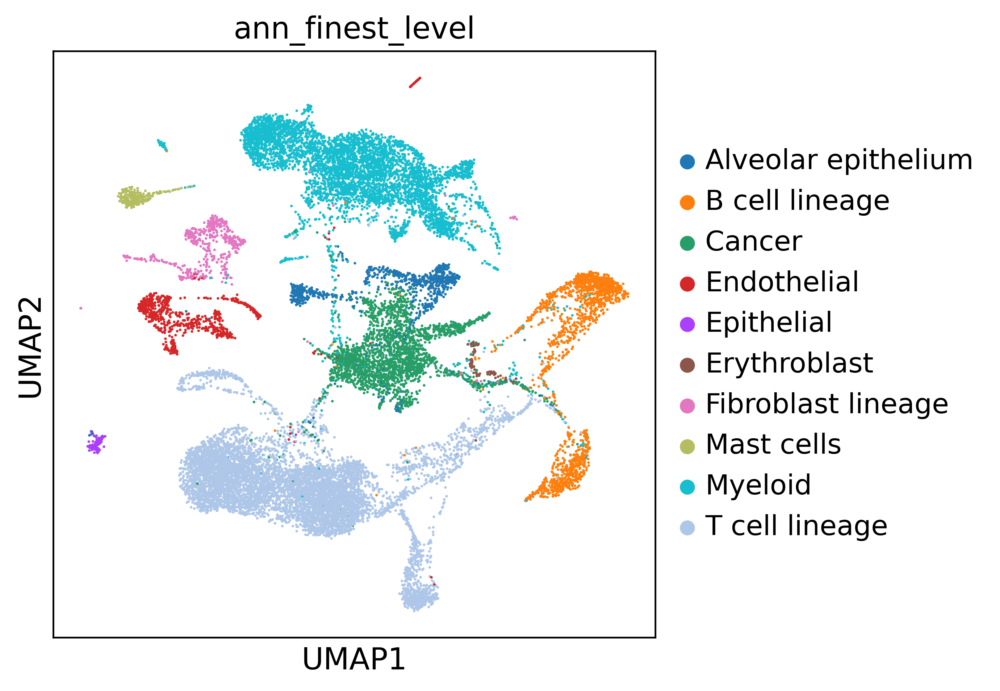

In [34]:
sc.pl.umap(adata_latent_sub, color='ann_finest_level')

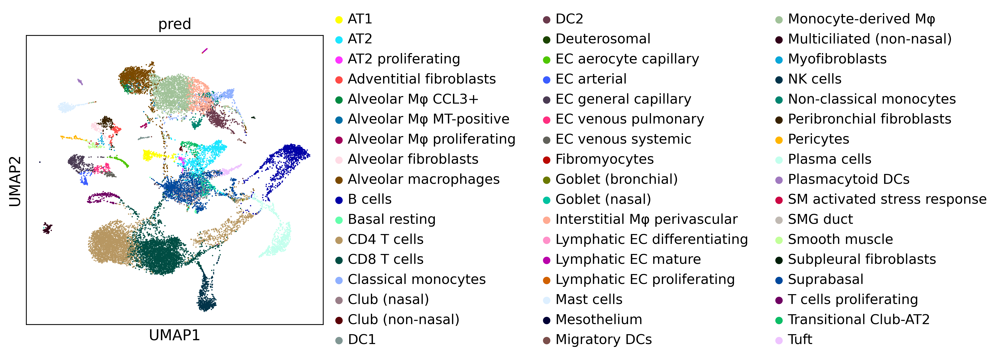

In [35]:
sc.pl.umap(adata_latent_sub, color='pred')

... storing 'unknown' as categorical


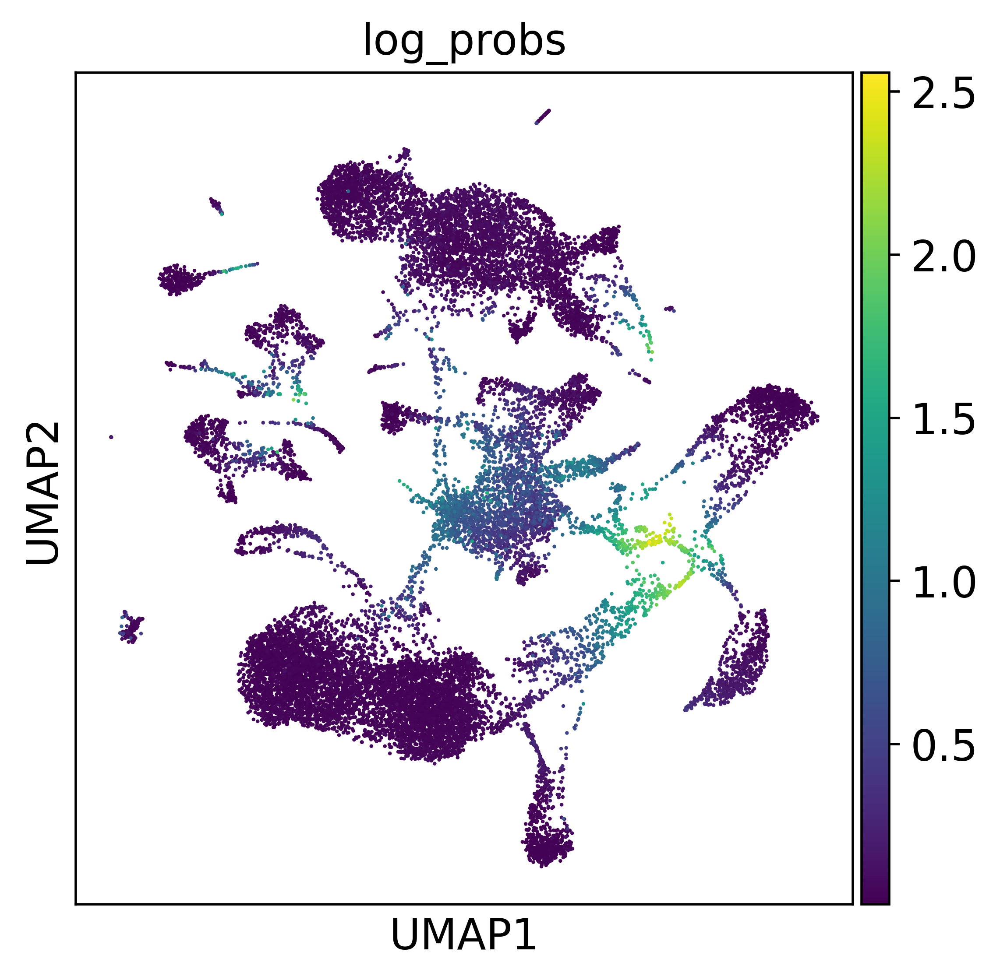

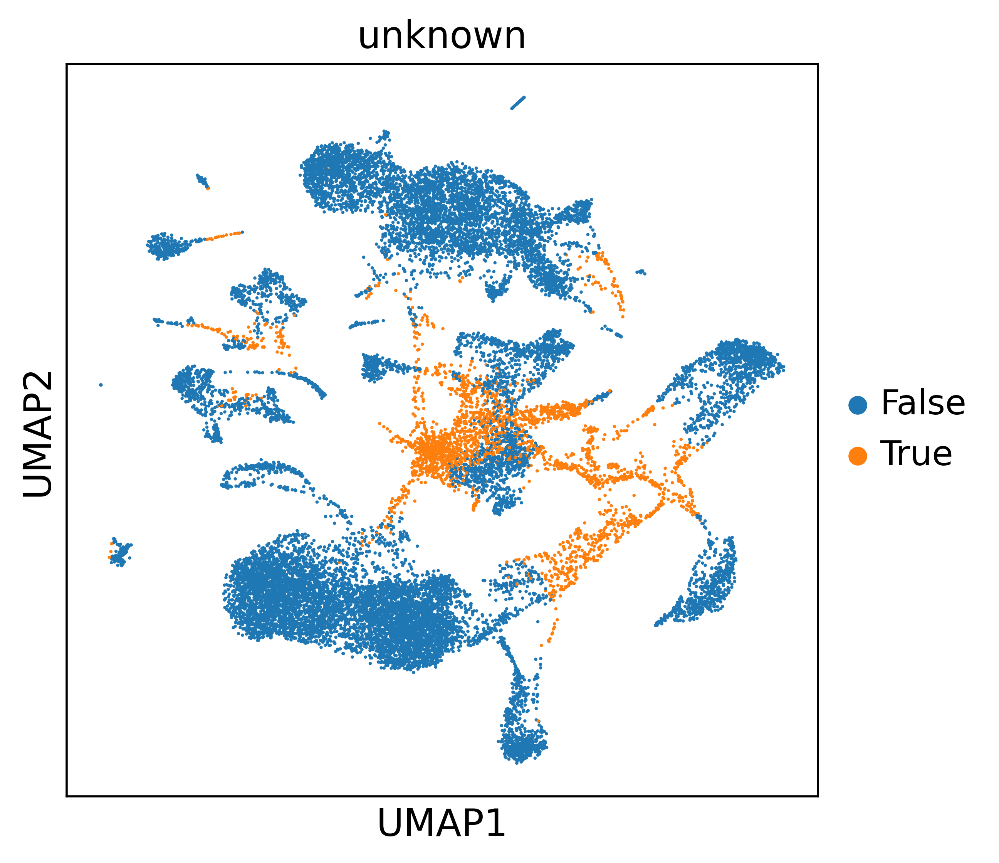

In [39]:
adata_latent_sub.obs['log_probs'] = np.log1p(adata_latent_sub.obs['probs'])
adata_latent_sub.obs['unknown'] = (adata_latent_sub.obs['log_probs'] > .5)
adata_latent_sub.obs['unknown'] = adata_latent_sub.obs['unknown'].astype(str)
sc.pl.umap(adata_latent_sub, color='log_probs')
sc.pl.umap(adata_latent_sub, color='unknown')

... storing 'outcome' as categorical


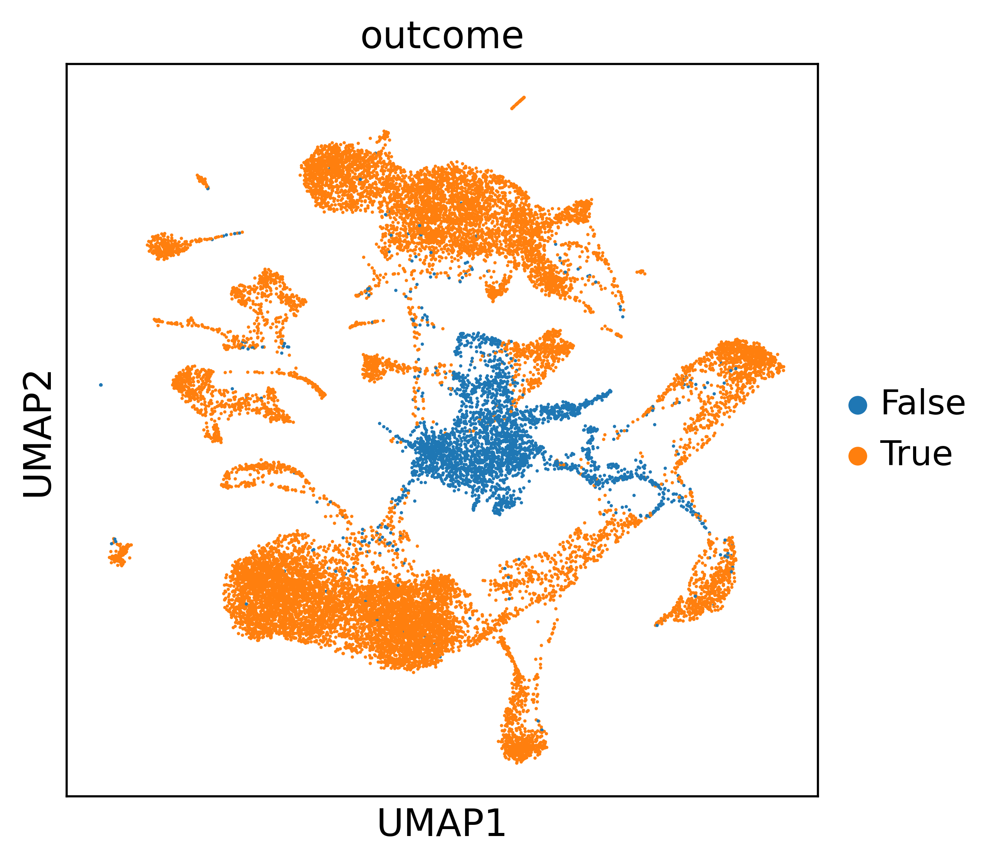

In [40]:
adata_latent_sub.obs['outcome'] = adata_latent_sub.obs['outcome'].astype(str)
sc.pl.umap(adata_latent_sub, color='outcome')

In [41]:
labeled_set_euclidean = lataq_query.get_landmarks_info()
labeled_set_euclidean.obs[condition_key] = 'labeled landmark euclidean'
unlabeled_set_euclidean = lataq_query.get_landmarks_info(landmark_set='unlabeled')
unlabeled_set_euclidean.obs[condition_key] = 'unlabeled landmark euclidean'

In [42]:
full_latent = adata_latent_sub.concatenate([
    labeled_set_euclidean, 
    unlabeled_set_euclidean,
])
full_latent

AnnData object with n_obs × n_vars = 20104 × 50
    obs: 'n_genes_detected', 'total_counts', 'cell_from_tumor', 'subject_ID', 'tumor_site', 'original_celltype_ann', 'sample', 'study', 'study_long', 'dataset', 'last_author_PI', 'lung_vs_nasal', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'ann_highest_res', 'ann_new', 'scanvi_label', 'ann_finest_level', 'probs', 'pred', 'gini', 'outcome', 'log_probs', 'unknown', 'ann_finest_level_pred', 'ann_finest_level_prob', 'batch'

In [43]:
sc.pp.pca(full_latent)
sc.pp.neighbors(full_latent)
sc.tl.leiden(full_latent)
sc.tl.umap(full_latent)

computing PCA
    with n_comps=49
    finished (0:00:00)
computing neighbors
    using data matrix X directly
    finished (0:00:04)
running Leiden clustering
    finished (0:00:02)
computing UMAP
    finished (0:00:26)


computing PCA
    with n_comps=49
    finished (0:00:00)


... storing 'subject_ID' as categorical


labeled landmark euclidean


... storing 'tumor_site' as categorical
... storing 'original_celltype_ann' as categorical
... storing 'sample' as categorical
... storing 'study' as categorical
... storing 'study_long' as categorical
... storing 'dataset' as categorical
... storing 'last_author_PI' as categorical
... storing 'lung_vs_nasal' as categorical
... storing 'ann_level_1' as categorical
... storing 'ann_level_2' as categorical
... storing 'ann_level_3' as categorical
... storing 'ann_level_4' as categorical
... storing 'ann_level_5' as categorical
... storing 'scanvi_label' as categorical
... storing 'ann_finest_level' as categorical
... storing 'pred' as categorical
... storing 'outcome' as categorical
... storing 'unknown' as categorical
... storing 'ann_finest_level_pred' as categorical


Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


unlabeled landmark euclidean


<ipython-input-44-781d47293d61>:31: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  fig.tight_layout()


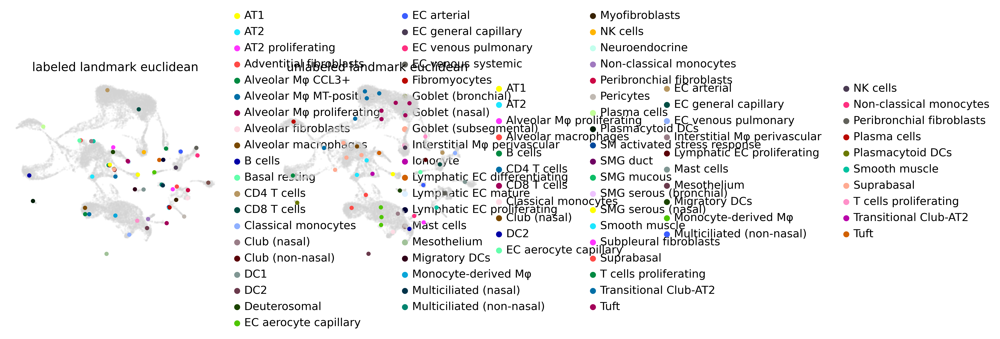

In [44]:
landmark_keys = [
    "labeled landmark euclidean",
    "unlabeled landmark euclidean"
]
cell_type_coldict = adata_latent_sub.uns['pred_colors']
fig, ax = plt.subplots(1, 2, figsize=(10, 4))
ax = ax.flatten()
sc.pp.pca(full_latent)
for i, key in enumerate(landmark_keys):
    print(key)
    sc.pl.umap(
        full_latent, 
        #color=cell_type_key,
        size=20,
        alpha=0.2, 
        show=False, 
        palette=cell_type_coldict,
        ax=ax[i]
    )
    ax[i].legend([])
    sc.pl.umap(
        full_latent[full_latent.obs[condition_key] == key],
        size=100,
        color=[cell_type_key[0] + '_pred'],
        ax=ax[i],
        show=False,
        palette=cell_type_coldict,
        frameon=False,
    )
    ax[i].set_title(key)
fig.tight_layout()

Trying to set attribute `.uns` of view, copying.


Text(0.5, 1.0, 'Landmarks')

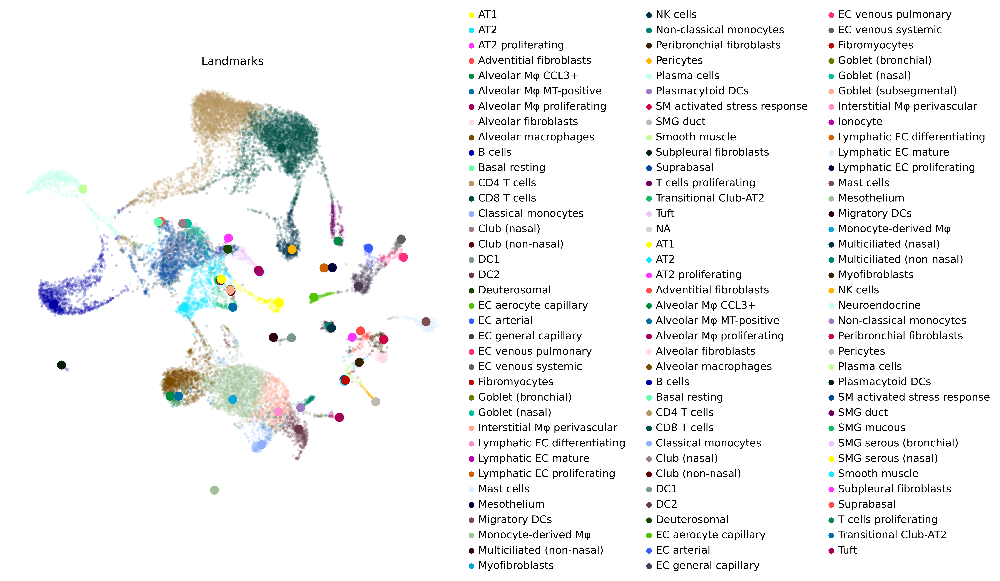

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
sc.pl.umap(
    full_latent, 
    color='pred',
    size=50,
    alpha=0.2, 
    show=False, 
    palette=cell_type_coldict,
    ax=ax
)
ax.legend([])
sc.pl.umap(
    full_latent[full_latent.obs[condition_key] == 'labeled landmark euclidean'],
    size=500,
    color=[cell_type_key[0] + '_pred'],
    ax=ax,
    show=False,
    palette=cell_type_coldict,
    frameon=False,
)
#sc.pl.umap(
#    full_latent[full_latent.obs[condition_key] == 'unlabeled landmark euclidean'],
#    size=100,
#    color=[cell_type_key[0] + '_pred'],
#    ax=ax,
#    show=False,
#    palette=cell_type_coldict,
#    frameon=False,
#    alpha=0.5,
#)
ax.set_title('Landmarks')
#fig.tight_layout()

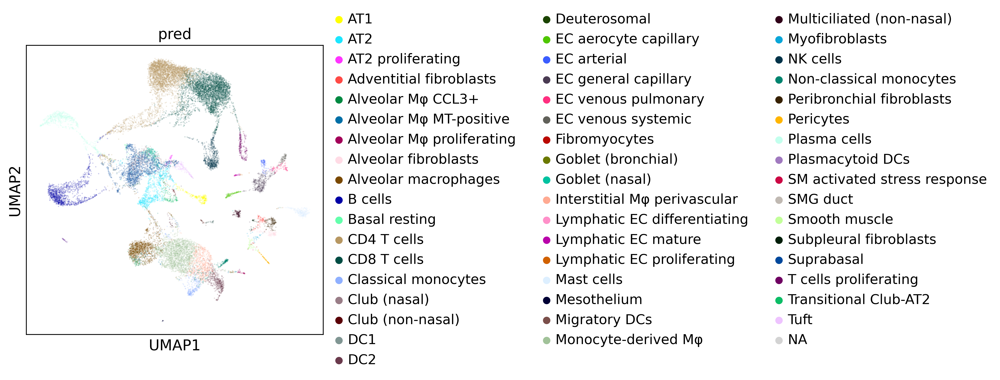

In [46]:
sc.pl.umap(
    full_latent, 
    color='pred',
    alpha=0.2, 
    palette=cell_type_coldict
)

In [47]:
for i in range(len(cell_type_key)):
    preds = results_dict[cell_type_key[i]]['preds']
    probs = results_dict[cell_type_key[i]]['probs']
    classification_df = pd.DataFrame(
        classification_report(
            y_true=adata_raw.obs[cell_type_key[i]], 
            y_pred=preds,
            output_dict=True
        )
    ).transpose()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(a

In [40]:
classification_df

,precision,recall,f1-score,support
AT1,0.000000,0.000000,0.000000,0.000000
AT2,0.000000,0.000000,0.000000,0.000000
AT2 proliferating,0.000000,0.000000,0.000000,0.000000
Adventitial fibroblasts,0.000000,0.000000,0.000000,0.000000
Alveolar Mφ proliferating,0.000000,0.000000,0.000000,0.000000
Alveolar epithelium,0.000000,0.000000,0.000000,4052.000000
Alveolar fibroblasts,0.000000,0.000000,0.000000,0.000000
Alveolar macrophages,0.000000,0.000000,0.000000,0.000000
B cell lineage,0.000000,0.000000,0.000000,7314.000000
B cells,0.000000,0.000000,0.000000,0.000000


In [48]:
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
from sklearn.decomposition import KernelPCA
pca = KernelPCA(n_components=2, kernel='cosine')
emb_pca = pca.fit_transform(embedding)


In [56]:
(adata_latent_concat
.obs
.groupby(condition_key)
.first()
)

,is_primary_data,assay_ontology_term_id,cell_type_ontology_term_id,development_stage_ontology_term_id,disease_ontology_term_id,ethnicity_ontology_term_id,tissue_ontology_term_id,organism_ontology_term_id,sex_ontology_term_id,sample,...,study_long,last_author_PI,lung_vs_nasal,ann_new,probs,pred,gini,outcome,batch,query
subject_ID,,,,,,,,,,,,,,,,,,,,,
284C,False,EFO:0009899,CL:1001603,HsapDv:0000151,PATO:0000461,HANCESTRO:0005,UBERON:0008946,NCBITaxon:9606,PATO:0000384,7119453,...,NaN,NaN,NaN,None,NaN,NaN,NaN,None,0,False
290B,False,EFO:0009899,CL:0002399,HsapDv:0000156,PATO:0000461,unknown,UBERON:0008946,NCBITaxon:9606,PATO:0000383,7135920,...,NaN,NaN,NaN,None,NaN,NaN,NaN,None,0,False
292B,False,EFO:0009899,CL:1001603,HsapDv:0000151,PATO:0000461,HANCESTRO:0005,UBERON:0008946,NCBITaxon:9606,PATO:0000384,7239213,...,NaN,NaN,NaN,None,NaN,NaN,NaN,None,0,False
296C,False,EFO:0009899,CL:0000861,HsapDv:0000126,PATO:0000461,HANCESTRO:0005,UBERON:0008946,NCBITaxon:9606,PATO:0000383,7185212,...,NaN,NaN,NaN,None,NaN,NaN,NaN,None,0,False
298C,False,EFO:0009899,CL:0002543,HsapDv:0000144,PATO:0000461,HANCESTRO:0005,UBERON:0008946,NCBITaxon:9606,PATO:0000384,7239219,...,NaN,NaN,NaN,None,NaN,NaN,NaN,None,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lambrechts_4,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BT1295,...,KULeuven_Thienpont_2018Lambrechts,Thienpont,lung,False,0.035349,CD8 T cells,0.359972,True,1,True
lambrechts_5,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BT1298,...,KULeuven_Thienpont_2018Lambrechts,Thienpont,lung,False,0.374086,Club (nasal),0.444179,False,1,True
lambrechts_6,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,BT1375,...,KULeuven_Thienpont_2018Lambrechts,Thienpont,lung,False,0.562600,Club (nasal),0.446071,False,1,True


In [54]:
lataq_query.conditions_

['Donor_05',
 'donor 2',
 'Donor_07',
 'T164',
 'donor 3',
 'donor 1',
 'VUHD103',
 'GRO-03',
 'GRO-10',
 'Donor_03',
 'VUHD68',
 'NU_CZI02',
 'VUHD92',
 'T165',
 'VUHD67',
 'Donor_06',
 'T121',
 'D363',
 'GRO-08',
 '296C',
 'lafy_donor_1',
 'VUHD071',
 '302C',
 'THD0012',
 'lafy_donor_6',
 'D372',
 '368C',
 'GRO-06',
 'GRO-01',
 'GRO-02',
 'T154',
 'NU_CZI01',
 'D326',
 'GRO-09',
 'VUHD94',
 '390C',
 'THD0009',
 '2020-3173-NC004',
 'VUHD70',
 'T90',
 'THD0005',
 'T166',
 'T89',
 'D353',
 'D337',
 'D354',
 'D344',
 '290B',
 '356C',
 'Donor_04',
 'lafy_donor_3',
 'VUHD98',
 '2020-3173-NC008',
 'D339',
 'lafy_donor_4',
 'Donor_08',
 'D367',
 'VUHD95',
 'Donor_01',
 'T137',
 'THD0019',
 'THD0015',
 '2020-3173-NC006',
 '2020-3173-NC002',
 'VUHD106',
 'THD0007',
 'T120',
 'THD0008',
 'D322',
 'VUHD104',
 'Donor_02',
 'VUHD84',
 'VUHD101',
 'T167',
 'THD0020',
 'T85',
 'THD0001',
 'THD0006',
 'VUHD66',
 'GRO-04',
 'T101',
 'THD0017',
 'T126',
 '2020-3173-NC005',
 'GRO-11',
 'VUHD080',
 '292B

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


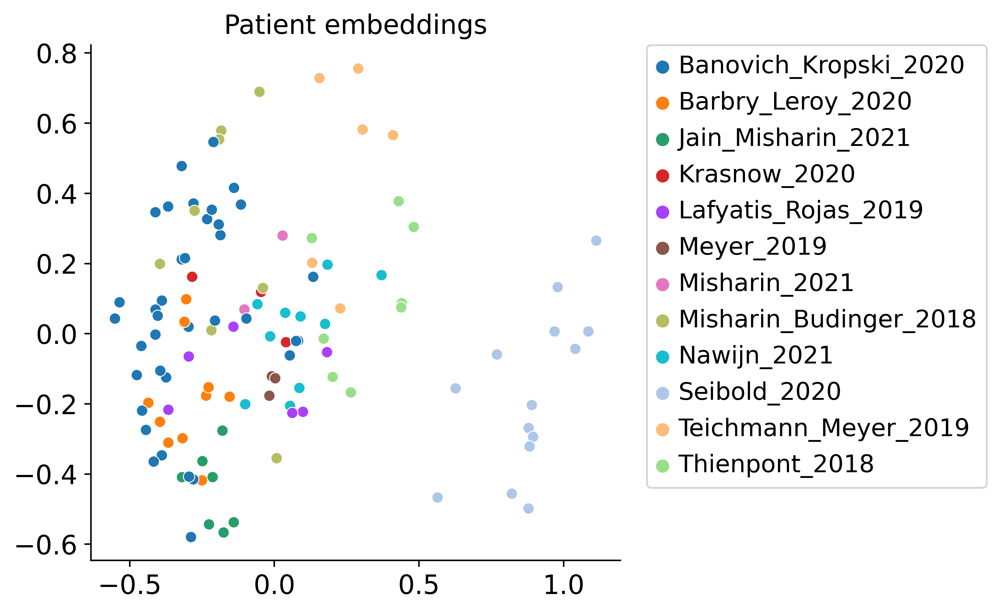

In [52]:
from sklearn.decomposition import KernelPCA

plot_key = 'study'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
pca = KernelPCA(n_components=5, kernel='cosine')
emb_pca = pca.fit_transform(embedding)
cond = (
    adata_latent_concat
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


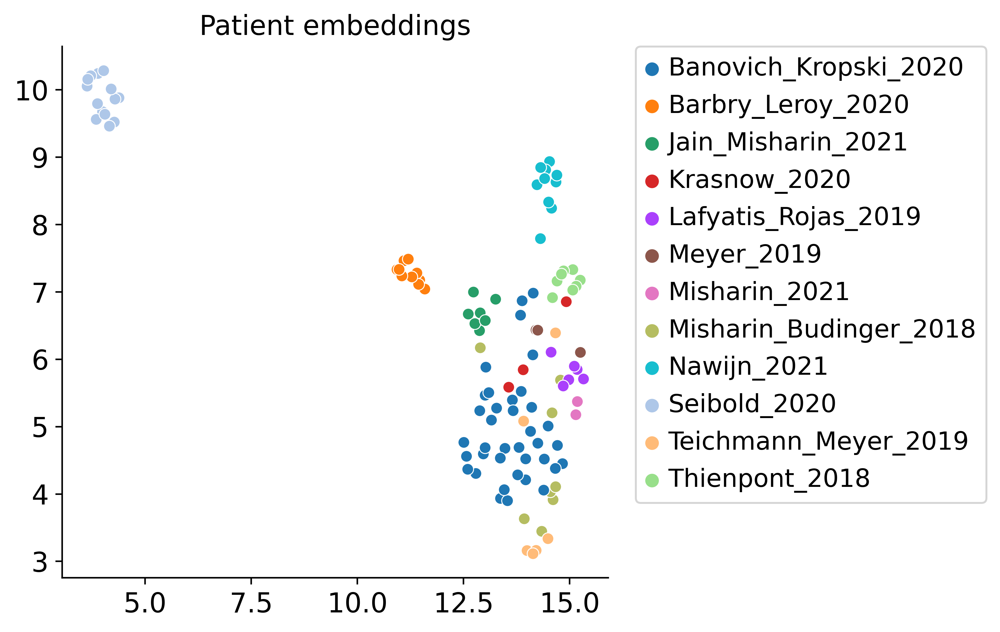

In [58]:
from sklearn.decomposition import KernelPCA
from umap import UMAP

plot_key = 'study'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP()
emb_pca = umap.fit_transform(embedding)

cond = (
    adata_latent_concat
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


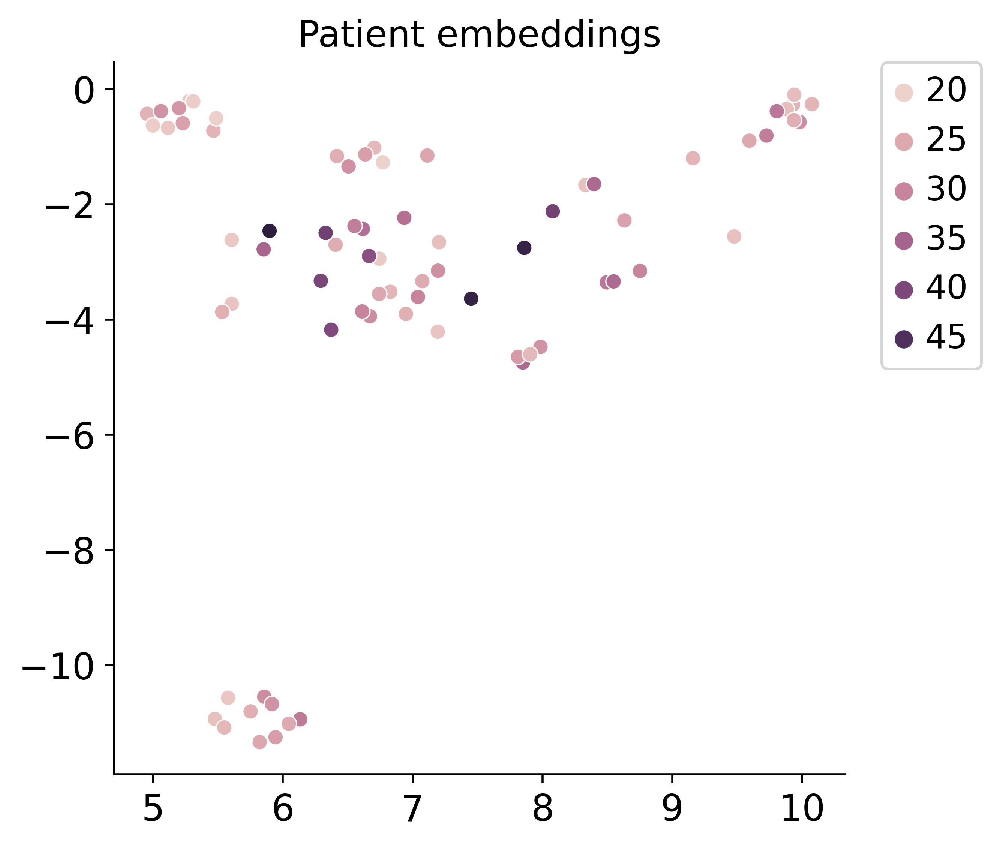

In [60]:
plot_key = 'BMI'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
umap = UMAP()
emb_pca = umap.fit_transform(embedding)
cond = (
    adata_latent_concat
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


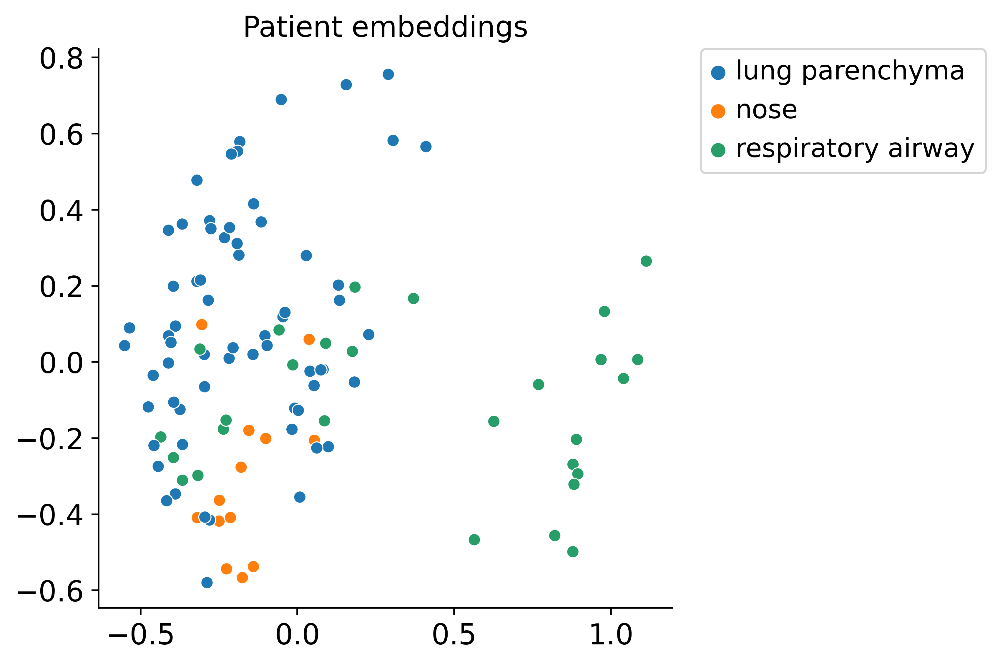

In [63]:
from sklearn.decomposition import KernelPCA

plot_key = 'tissue'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
pca = KernelPCA(n_components=5, kernel='cosine')
emb_pca = pca.fit_transform(embedding)
cond = (
    adata_latent_concat
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()

/home/icb/carlo.dedonno/anaconda3/envs/lataq_cuda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y, hue. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


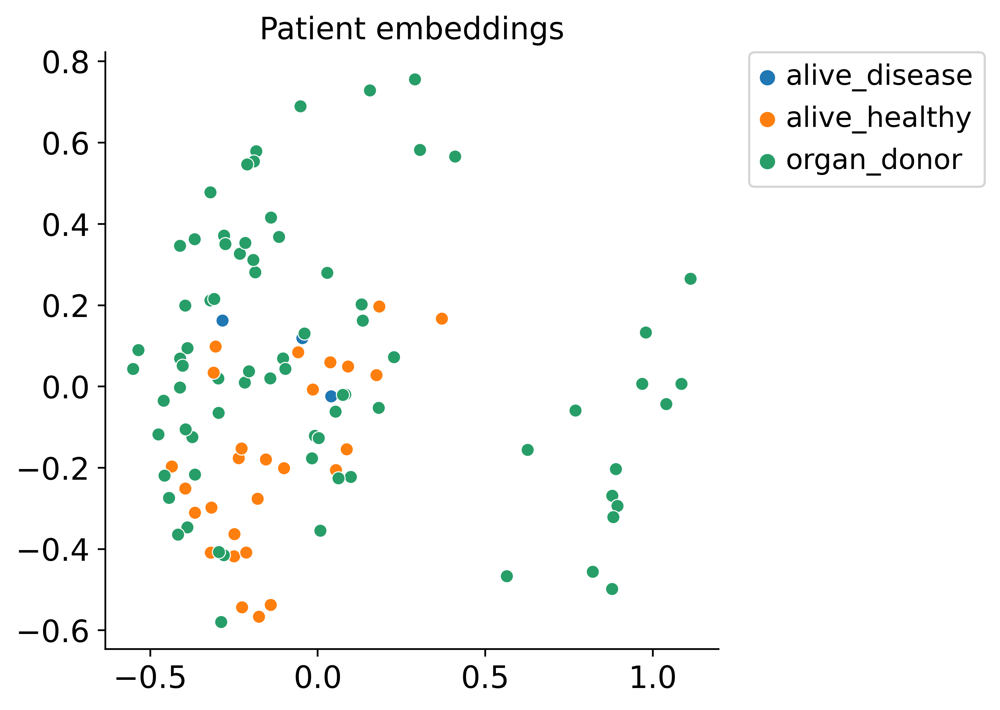

In [64]:
from sklearn.decomposition import KernelPCA

plot_key = 'subject_type'
embedding = lataq_query.model.embedding.weight.detach().cpu().numpy()
pca = KernelPCA(n_components=5, kernel='cosine')
emb_pca = pca.fit_transform(embedding)
cond = (
    adata_latent_concat
    .obs
    .groupby(condition_key)
    .first()
    .reindex(lataq_query.conditions_)
    [plot_key]
)
patient_id = lataq_query.conditions_

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
import seaborn as sns
sns.scatterplot(
    emb_pca[:, 0], 
    emb_pca[:, 1], 
    cond,
    #hue_order = cond_to_keep,
    #palette = 'Reds',
    ax=ax
)

#for i in range(emb_pca.shape[0]):
#    ax.text(
#        x=emb_pca[i, 0]+0.01,
#        y=emb_pca[i, 1]+0.01,
#        s=patient_id[i],
#        fontsize=5
#    )
ax.grid(False)
ax.set_title('Patient embeddings')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
sns.despine()